**Personal information**

| Family name | First name | Email address            |
| ----------- | ---------- | ------------------------ |
| Di Gianvito | Angelo     | angelo.digianvito@bse.eu |

# Image Semantic segmentation - U-Net

This tutorial explores how to extract automatically building footprints from aerial images. We want to approximate the function mapping input images to a binary prediction for each pixel (i.e. semantic segmentation) using the U-Net convolutional network architecture [(Ronneberger et al. 2015)](https://link.springer.com/chapter/10.1007/978-3-319-24574-4_28). For this task, the GPU implementation of TensorFlow is recommended.

The image data consists of 3347 colour raster of dimension 256x256x3 using the NAD83 (EPSG:26986) projection system. Each raster represents an area of 300 square meters in the state of Massachusetts. The label data consists of building footprints vectors extracted from [OpenStreetMap](https://www.openstreetmap.org/relation/61315) and converted into a binary raster with the same extent and resolution as the image rasters. The unformatted data was provided by Minh (2013) and can be accessed on his [website](http://www.cs.toronto.edu/~vmnih/data/). Images and labels are randomly partitioned into a training (70%) validation (15%) and test sample (15%).

Tensorflow Keras documentation:
- [Convolution](https://keras.io/api/layers/convolution_layers/)
- [Activation](https://keras.io/api/layers/activations/)
- [Pooling](https://keras.io/api/layers/pooling_layers/)
- [Regularisation](https://keras.io/api/layers/regularization_layers/)
- [Optimisers](https://keras.io/api/optimizers/)
- [Metrics](https://keras.io/api/metrics/)
- [Losses](https://keras.io/api/losses/)
- [Callbacks](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks)

![U-Net model](https://www.dropbox.com/scl/fi/wgvqiix6scbm1c983ephk/segmentation_model.jpg?rlkey=71blfq7cm1yzw26puu4l0ybhs&dl=1)

In [13]:
# Packages
import numpy as np
import tensorflow as tf
import os
import shutil
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve

from segmentation_utilities import *
from tensorflow.keras import callbacks, layers, losses, metrics, models, optimizers, preprocessing, utils
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import SpatialDropout2D
from tensorflow.keras.models import save_model, load_model
from tensorflow.keras.callbacks import EarlyStopping
from urllib import request
import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from tensorflow.keras import layers, models
from tensorflow.keras import callbacks, datasets, initializers, layers, losses, models, optimizers, preprocessing, utils
from sklearn.metrics import precision_recall_curve

# Checks tensorFlow
print('TensorFlow version:', tf.__version__)
print('GPU available:', len(tf.config.list_physical_devices('GPU')))

TensorFlow version: 2.16.1
GPU available: 1


### Metrics util class
(Included in segmentation utils)

In [ ]:
class Metrics:
    def __init__(self):
        self.results = {}

    def run(self, y_true, y_pred, method_name, average='macro'):
        # Calculate metrics
        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred, average=average)
        recall = recall_score(y_true, y_pred, average=average)
        f1 = f1_score(y_true, y_pred, average=average)

        # Store results
        self.results[method_name] = {
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
        }

    def plot(self):
        # Create subplots
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))

        # Plot each metric
        for i, metric in enumerate(['accuracy', 'precision', 'recall', 'f1']):
            ax = axs[i//2, i%2]
            values = [res[metric] * 100 for res in self.results.values()]
            ax.bar(self.results.keys(), values)
            ax.set_title(metric)
            ax.set_ylim(0, 100)

            # Add values on the bars
            for j, v in enumerate(values):
                ax.text(j, v + 0.02, f"{v:.2f}", ha='center', va='bottom')

        plt.tight_layout()
        plt.show()

In [2]:
# Utilities
def download_data() -> None:
    '''Downloads data folder'''
    request.urlretrieve('https://www.dropbox.com/scl/fo/s84ncdd29jokky00b5kwb/ABF1sS8NIhilM1N1-CF8w7Y?rlkey=si6j7dy9eg2mq0mwid2ytd53l&dl=1', 'data.zip')
    shutil.unpack_archive('data.zip', 'data')
    os.remove('data.zip')    
    os.chdir('data')

# Defines paths
paths = dict(
    images_train='data/training/images',
    labels_train='data/training/labels',
    images_valid='data/validation/images',
    labels_valid='data/validation/labels',
    images_test= 'data/test/images',
    labels_test= 'data/test/labels'
)

1. Loading the images and labels for the training and validation samples as separate `numpy.ndarray` of dimensions $n \times h \times w \times d$. 

In [3]:
# # Loads dataset
# download_data() # On first execution

In [4]:
# Loads training data
images_train   = np.array([read_raster(file, dtype=np.ubyte)  for file in search_files(paths['images_train'],   pattern='tif$')])
labels_train   = np.array([read_raster(file, dtype=np.ubyte)  for file in search_files(paths['labels_train'],   pattern='tif$')])
images_valid   = np.array([read_raster(file, dtype=np.ubyte)  for file in search_files(paths['images_valid'],   pattern='tif$')])
labels_valid   = np.array([read_raster(file, dtype=np.ubyte)  for file in search_files(paths['labels_valid'],   pattern='tif$')])
images_test   = np.array([read_raster(file, dtype=np.ubyte)  for file in search_files(paths['images_test'],   pattern='tif$')])
labels_test   = np.array([read_raster(file, dtype=np.ubyte)  for file in search_files(paths['labels_test'],   pattern='tif$')])

Normalizing the images to allow pixel values to be in a consistent range.

In [5]:
def normalize_image(image_array):
    return image_array.astype(np.float32)/255

In [6]:
images_train_norm = normalize_image(images_train)
images_valid_norm = normalize_image(images_valid)
images_test_norm = normalize_image(images_test)

Setting labels to float.

In [7]:
labels_train_float = labels_train.astype(np.float32)
labels_valid_float = labels_valid.astype(np.float32)
labels_test_float = labels_test.astype(np.float32)

2. Checking the dimensions of the images and labels arrays. Display several matching image and label pairs to ensure correspondence.

Checking for dimensionality consistency

In [8]:
def check_dimension_and_display(image_array, label_array, n_samples=3):
    print(f"Shape images: {image_array.shape}")
    print(f"Shape labels: {label_array.shape}")
    for i in range(n_samples):
        compare([image_array[i], label_array[i]], ['Image', 'Label'])
    

Training set

Shape images: (234, 256, 256, 3)
Shape labels: (234, 256, 256, 1)


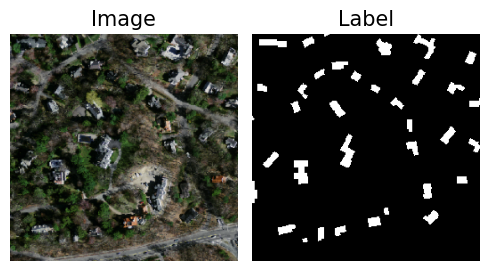

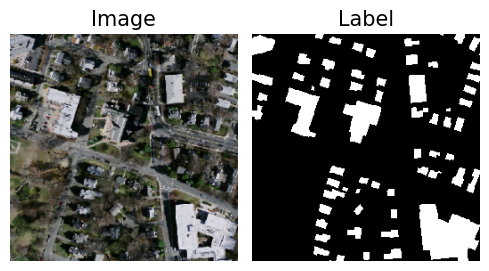

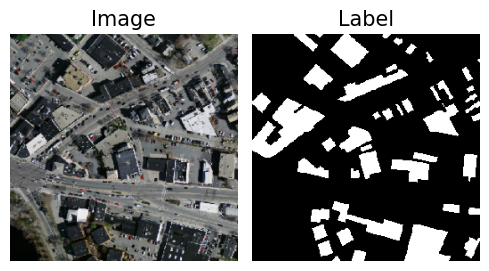

In [9]:
check_dimension_and_display(images_train_norm, labels_train_float)

Images come in three channels while label masks are just 1 channel, remaining dimensions are consistent.

Validation set

Shape images: (50, 256, 256, 3)
Shape labels: (50, 256, 256, 1)


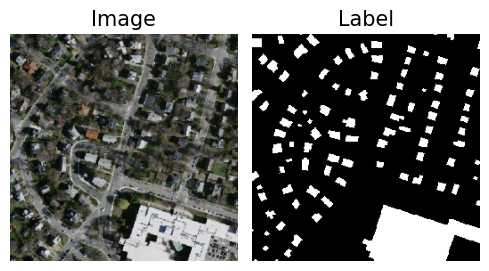

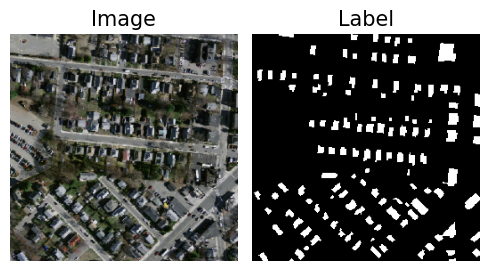

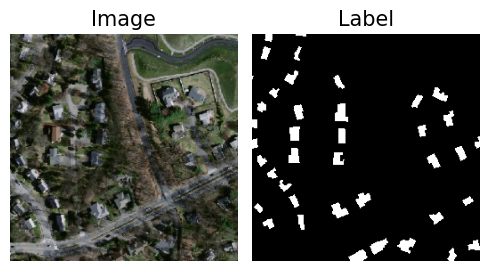

In [10]:
check_dimension_and_display(images_valid_norm, labels_valid_float)

Testing set

Shape images: (50, 256, 256, 3)
Shape labels: (50, 256, 256, 1)


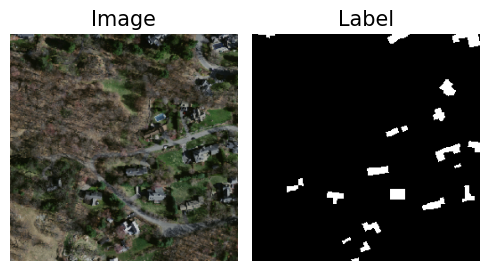

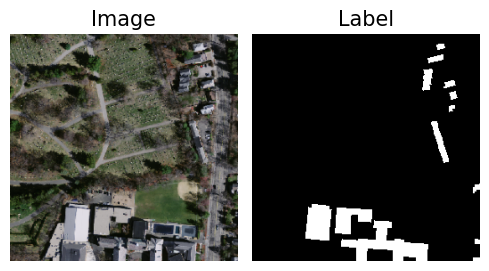

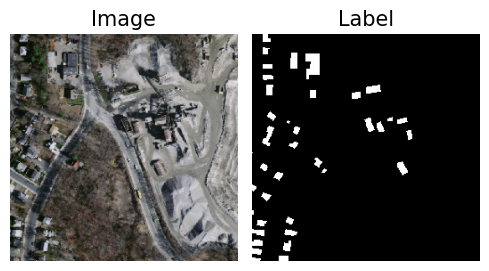

In [11]:
check_dimension_and_display(images_test_norm, labels_test_float)

3. Using the Keras functional API, define a simplified U-Net model with the number of kernels indicated in the figure.

![U-Net model](https://www.dropbox.com/scl/fi/wgvqiix6scbm1c983ephk/segmentation_model.jpg?rlkey=71blfq7cm1yzw26puu4l0ybhs&dl=1)

U-net architecture:

- The Encoder part uses 5 convolutional blocks that apply 3x3xd filters(d is the number of features of the current block). 
- The Decoder is composed by 4 convolutional blocks that are intermitted by transpose convolution operations.
- Output layer that uses 1x1 kernels to compute predictions on a pixel level

In [16]:
def get_model(img_size):
    initializer = initializers.HeNormal(seed=0)
    inputs = layers.Input(img_size+(3,), name='input_layer')
    # Encoder

    conv1 = layers.Conv2D(8, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer1.0')(inputs)
    conv1 = layers.Conv2D(8, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer1.1')(conv1)
    pool1 = layers.MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = layers.Conv2D(16, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer2.0')(pool1)
    conv2 = layers.Conv2D(16, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer2.1')(conv2)
    pool2 = layers.MaxPooling2D(pool_size=(2, 2))(conv2)
    
    conv3 = layers.Conv2D(32, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer3.0')(pool2)
    conv3 = layers.Conv2D(32, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer3.1')(conv3)
    pool3 = layers.MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = layers.Conv2D(64, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer4.0')(pool3)
    conv4 = layers.Conv2D(64, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer4.1')(conv4)
    pool4 = layers.MaxPooling2D(pool_size=(2, 2))(conv4)

    # Bottleneck
    conv5 = layers.Conv2D(128, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer5.0')(pool4)
    conv5 = layers.Conv2D(128, kernel_size=(3,3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer5.1')(conv5)

    # Decoder
    up6 = layers.Conv2DTranspose(64, kernel_size=(2, 2), strides=(2, 2), padding='same', name='deconv_layer6.0')(conv5)
    merge6 = layers.Concatenate(axis=3)([conv4, up6])

    conv6 = layers.Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer6.0')(merge6)
    conv6 = layers.Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer6.1')(conv6)
    
    up7 = layers.Conv2DTranspose(32, kernel_size=(2, 2), strides=(2, 2), padding='same', name='deconv_layer7.0')(conv6)
    merge7 = layers.Concatenate(axis=3)([conv3, up7])
    conv7 = layers.Conv2D(32, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer7.0')(merge7)
    conv7 = layers.Conv2D(32, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer7.1')(conv7)
    
    up8 = layers.Conv2DTranspose(16, kernel_size=(2, 2), strides=(2, 2), padding='same', name='deconv_layer8.0')(conv7)
    merge8 = layers.Concatenate(axis=3)([conv2, up8])
    conv8 = layers.Conv2D(16, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer8.0')(merge8)
    conv8 = layers.Conv2D(16, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer8.1')(conv8)
    
    up9 = layers.Conv2DTranspose(8, kernel_size=(2, 2), strides=(2, 2), padding='same', name='deconv_layer9.0')(conv8)
    merge9 = layers.Concatenate(axis=3)([conv1, up9])
    conv9 = layers.Conv2D(8, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer9.0')(merge9)
    conv9 = layers.Conv2D(8, kernel_size=(3, 3), padding='same', activation='relu', kernel_initializer=initializer, name='conv_layer9.1')(conv9)

    output = layers.Conv2D(1, kernel_size=(1,1),padding='same', activation='sigmoid', name='output_layer')(conv9)

    model = models.Model(inputs, output)
    return model


4. Initialise and compile the model using the chosen optimisation algorithm and the appropriate loss function. Optionally, you can use the focal version of the loss function to account for the class imbalance in the training data. Print the model structure using the `summary` method.

In [12]:
img_size = (256,256)
batch_size = 32
image_model = get_model(img_size)

In [47]:
# Compile the model
optimizer = keras.optimizers.Adam(learning_rate=0.001)
image_model.compile(optimizer=optimizer, loss=keras.losses.BinaryFocalCrossentropy() , metrics=['accuracy', 'precision', 'recall'])

# Summary of the model
image_model.summary()

Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer1.0       │ (None, 256, 256,  │        224 │ input_layer[0][0] │
│ (Conv2D)            │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer1.1       │ (None, 256, 256,  │        584 │ conv_layer1.0[0]… │
│ (Conv2D)            │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_16    │ (None, 128, 128,  │          0 │ conv_layer1.1[0]… │
│ (MaxPooling2D)      │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer2.0       │ (None, 128, 128,  │      1,168 │ max_pooling2d_16… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer2.1       │ (None, 128, 128,  │      2,320 │ conv_layer2.0[0]… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_17    │ (None, 64, 64,    │          0 │ conv_layer2.1[0]… │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer3.0       │ (None, 64, 64,    │      4,640 │ max_pooling2d_17… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer3.1       │ (None, 64, 64,    │      9,248 │ conv_layer3.0[0]… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_18    │ (None, 32, 32,    │          0 │ conv_layer3.1[0]… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer4.0       │ (None, 32, 32,    │     18,496 │ max_pooling2d_18… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer4.1       │ (None, 32, 32,    │     36,928 │ conv_layer4.0[0]… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_19    │ (None, 16, 16,    │          0 │ conv_layer4.1[0]… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer5.0       │ (None, 16, 16,    │     73,856 │ max_pooling2d_19… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_layer5.1       │ (None, 16, 16,    │    147,584 │ conv_layer5.0[0]… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ deconv_layer6.0     │ (None, 32, 32,    │     32,832 │ conv_layer5.1[0]… │
│ (Conv2DTranspose)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_16      │ (None, 32, 32,    │          0 │ conv_layer4.1[0]

 Total params: 485,817 (1.85 MB)

 Trainable params: 485,817 (1.85 MB)

 Non-trainable params: 0 (0.00 B)

5. Estimating the model parameters using the training and the validation sample. Using batch-size of 32 and a maximum of 30 training epoch. Adding an early-stopping callback with a patience parameter of 3 to recover the parameters that minimise the error on the validation sample.

In [48]:
history = image_model.fit(images_train_norm, 
                labels_train_float, 
                batch_size=batch_size, 
                epochs=30, 
                callbacks=[EarlyStopping(patience=3, monitor='val_loss', restore_best_weights=True)],
                validation_data=[images_valid_norm, labels_valid_float])

Epoch 1/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.5881 - loss: 0.1843 - precision: 0.1137 - recall: 0.3695 - val_accuracy: 0.8663 - val_loss: 0.1341 - val_precision: 0.1389 - val_recall: 0.0058
Epoch 2/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 7s 883ms/step - accuracy: 0.8859 - loss: 0.1222 - precision: 0.1148 - recall: 0.0030 - val_accuracy: 0.8698 - val_loss: 0.1311 - val_precision: 0.2187 - val_recall: 0.0010
Epoch 3/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 6s 561ms/step - accuracy: 0.8908 - loss: 0.1124 - precision: 0.1884 - recall: 8.8880e-04 - val_accuracy: 0.8699 - val_loss: 0.1216 - val_precision: 0.2596 - val_recall: 0.0013
Epoch 4/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 5s 581ms/step - accuracy: 0.8823 - loss: 0.1127 - precision: 0.2253 - recall: 0.0012 - val_accuracy: 0.8700 - val_loss: 0.1151 - val_precision: 0.3040 - val_recall: 0.0013
Epoch 5/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 4s 519ms/step - accuracy: 0.8820 - loss: 0.1062 - precision: 0.2513 - recall: 0.0014 - val_accuracy: 0.8701 - val_loss: 0.1130 - v

In [49]:
# Save the model to a file
image_model.save('image_model.h5')

# Load the model from the file
# image_model = load_model('image_model.h5')

6. Displaying the evolution of the training and validation metrics during training using the provided `display_history` utility function.

[0.13413916528224945, 0.13110007345676422, 0.12164541333913803, 0.1150830090045929, 0.11296509951353073, 0.10001785308122635, 0.09250016510486603, 0.09288226813077927, 0.09070154279470444, 0.08694662153720856, 0.08616351336240768, 0.0848713144659996, 0.08679849654436111, 0.08356466144323349, 0.08190391212701797, 0.07874463498592377, 0.0770912617444992, 0.08124147355556488, 0.08193997293710709, 0.08173500746488571]


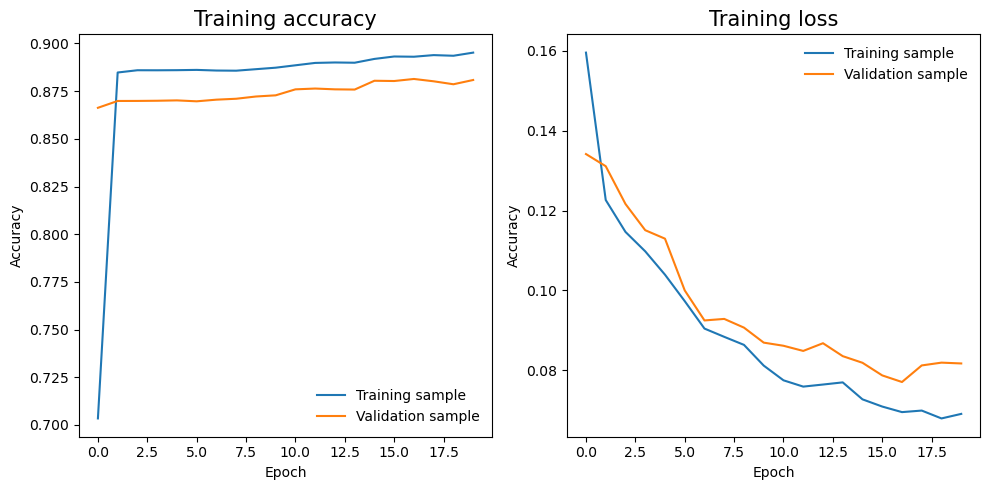

In [50]:
print(history.history['val_loss'])
display_history(history.history)

The history plot and the Early stopping callback show that the model has slowly converged. This per se shows that the model has been able to compute some reasonable updates to its parameters and reach a local minimum.

The validation loss is decreasing at a similar rate to the training loss showing that the model is not overfitting and it is generalizing underlying patterns well. The learning rate that worked best for the learning process was the default value for the Adam learning rate. After some iterations, the loss function that was outputing the best performance was the Binary Focal Crossentropy loss function, that was implemented to maximise training performance.

7. Computing the predicted probabilities for the test images. Turning the probabilities into binary predictions using a threshold of 0.5. 

In [51]:
# Predict probabilities for the test set
predicted_probabilities = image_model.predict(images_test_norm)

# Convert probabilities to binary predictions using a threshold of 0.5
binary_predictions = (predicted_probabilities > 0.5).astype(int)

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step


In [113]:
def compute_iou(y_true, y_pred):
    """
    Calculate Intersection over Union (IoU) for the entire image.

    Parameters:
    y_true (numpy.ndarray): Ground truth binary labels.
    y_pred (numpy.ndarray): Predicted binary labels.

    Returns:
    float: IoU score.
    """
    # Flatten the arrays to simplify calculation
    y_true_flat = y_true.flatten()
    y_pred_flat = y_pred.flatten()

    # Calculate TP, FP, FN
    TP = np.sum((y_true_flat == 1) & (y_pred_flat == 1))
    FP = np.sum((y_true_flat == 0) & (y_pred_flat == 1))
    FN = np.sum((y_true_flat == 1) & (y_pred_flat == 0))

    # Calculate IoU
    iou = TP / (TP + FP + FN)
    
    return iou

# Computing IoU with the builtin keras function
# iou_score = tf.keras.metrics.BinaryIoU(target_class_ids=[1], threshold=0.5)
# iou_score.update_state(labels_test_float, binary_predictions)

# print(f"IoU Score builtin: {iou_score.result().numpy()}")

# Computing IoU with a custom and more efficient (in Runtime) function
iou_score_ = compute_iou(labels_test_float, binary_predictions)
print(f"IoU Score computed: {iou_score_:.3f}")

IoU Score computed: 0.138


The IoU score is low showing that the model is not capturing very well the area of the buildings in the pictures or the threshold is not optimal.

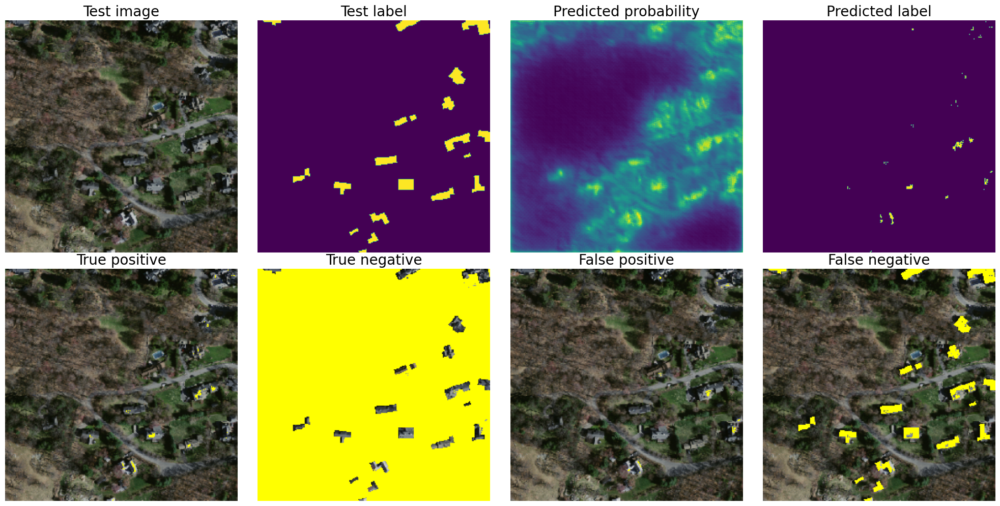

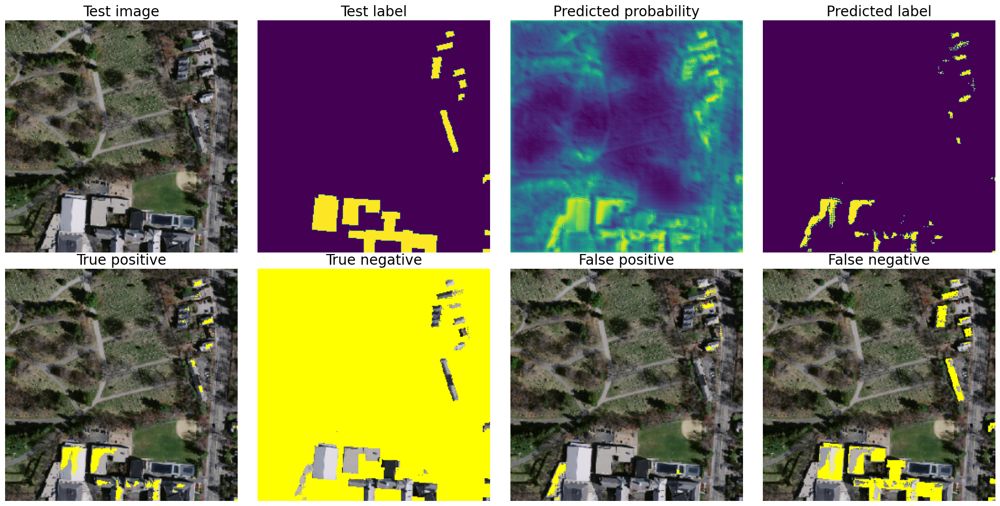

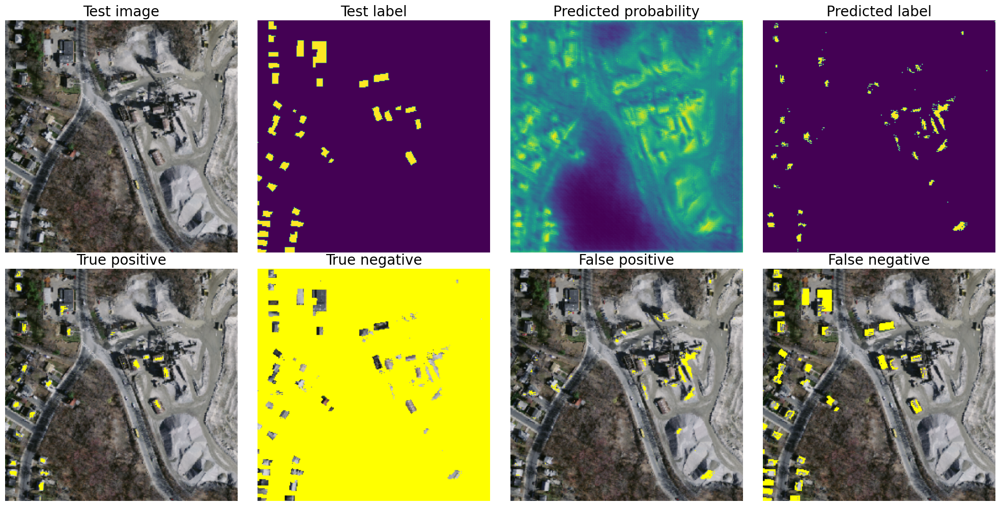

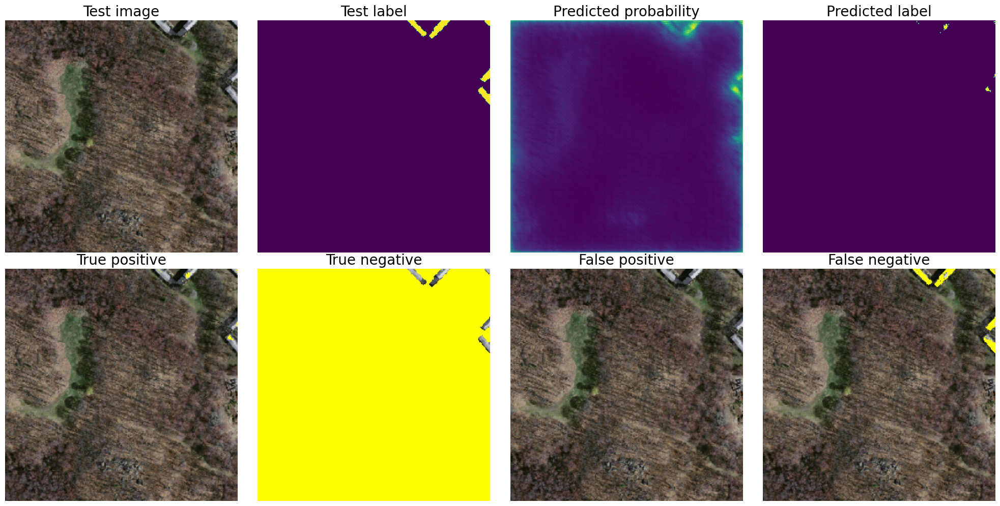

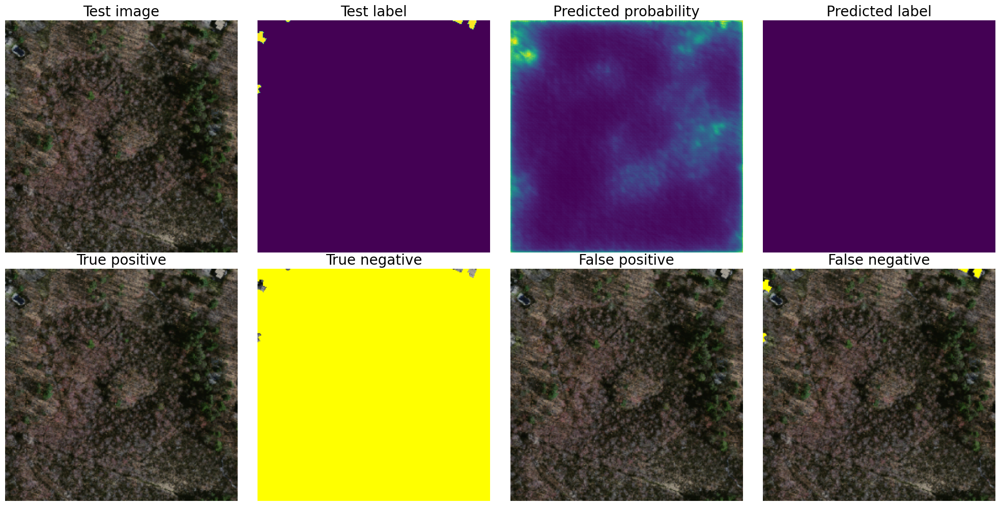

In [52]:
# Display prediction statistics

n_test_images = 5

for i in range(n_test_images):
    display_statistics(images_test_norm[i], labels_test_float[i], predicted_probabilities[i], binary_predictions[i])

The examples show that the model is capturing the areas of the buildings pretty well, but the False negative predictions show that the treshold probability chosen is not allowing for meaningful predictions as the model tends to assign the negative class to most of the pixels. Lowering the treshold will improve the model predicitons.

In [268]:
class Metrics:
    def __init__(self):
        self.results = {}

    def run(self, y_true, y_pred, method_name, average='macro'):
        # Calculate metrics
        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred, average=average)
        recall = recall_score(y_true, y_pred, average=average)
        f1 = f1_score(y_true, y_pred, average=average)

        # Store results
        self.results[method_name] = {
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
        }

    def plot(self):
        # Create subplots
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))

        # Plot each metric
        for i, metric in enumerate(['accuracy', 'precision', 'recall', 'f1']):
            ax = axs[i//2, i%2]
            values = [res[metric] * 100 for res in self.results.values()]
            ax.bar(self.results.keys(), values)
            ax.set_title(metric)
            ax.set_ylim(0, 100)

            # Add values on the bars
            for j, v in enumerate(values):
                ax.text(j, v + 0.02, f"{v:.2f}", ha='center', va='bottom')

        plt.tight_layout()
        plt.show()

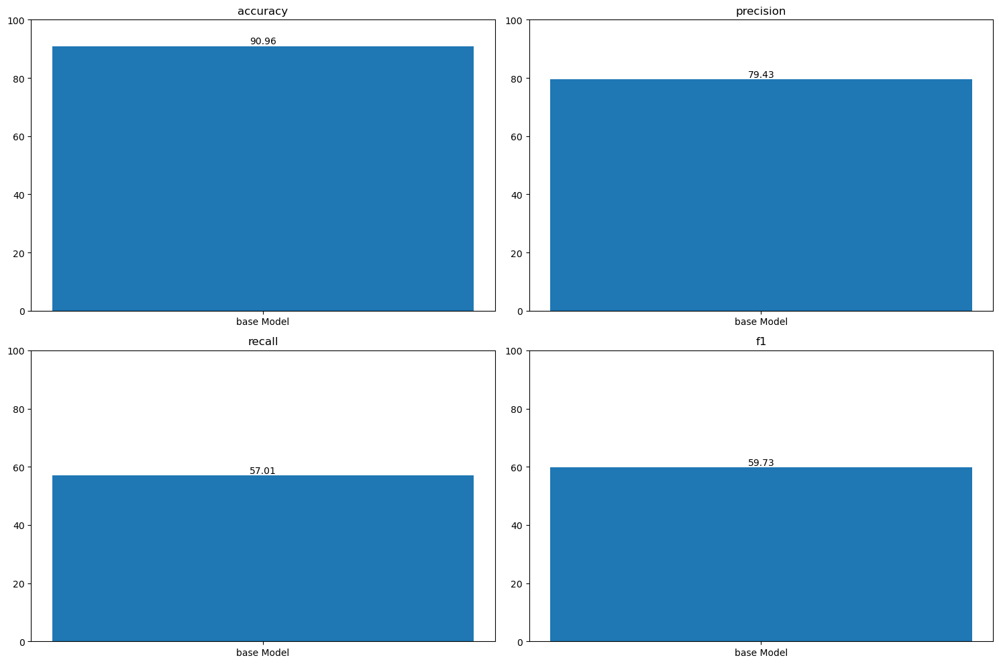

In [270]:
# Flatten the test labels
labels_test_flat = labels_test.reshape(-1)

metrics_val= Metrics()
metrics_val.run(labels_test_flat, binary_predictions.reshape(-1), "base Model")
metrics_val.plot()

Metrics show that the base model is performing very well in terms of accuracy and precision but less in recall. The resulting F1 is acceptable at 0.6.

8. Assuming that we give equal importance to reducing false positives and false negatives, using a decision probability threshold that strikes the best balance between these two quantities.

In [61]:
# Flatten the test labels
labels_test_flat = labels_test.reshape(-1)

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(labels_test_flat, predicted_probabilities.reshape(-1))
roc_auc = auc(fpr, tpr)

# Find the optimal threshold (we used the Youden's J statistic)
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold_roc = thresholds[optimal_idx]

# Coordinates of the optimal threshold
optimal_fpr = fpr[optimal_idx]
optimal_tpr = tpr[optimal_idx]

rounded_treshold = round(optimal_threshold_roc, 3)
print(rounded_treshold)

0.328


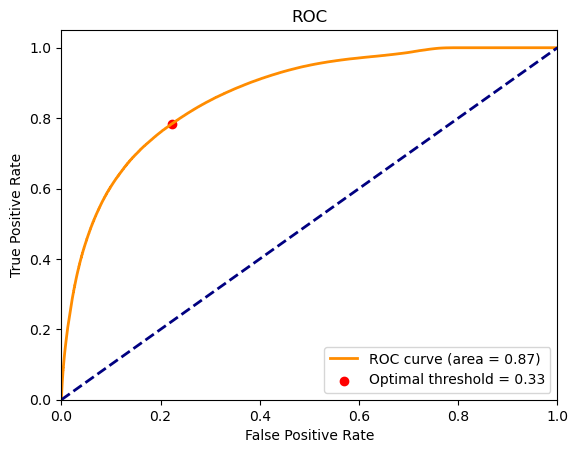

In [64]:
# Plot ROC curve
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.scatter([optimal_fpr], [optimal_tpr], color='red', marker='o', label=f'Optimal threshold = {rounded_treshold:.2f}')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.legend(loc="lower right")
plt.show()


In [110]:
# Check the preformance using Optimal Threshold (ROC)
binary_predictions_roc = (predicted_probabilities > optimal_threshold_roc).astype(int)
print(f'Mean IoU (ROC): {compute_iou(labels_test_float, binary_predictions_roc):.3f}')

Mean IoU (ROC): 0.257


Using the optimal treshold computed with the roc curve the IoU of the model is significanlty higher.

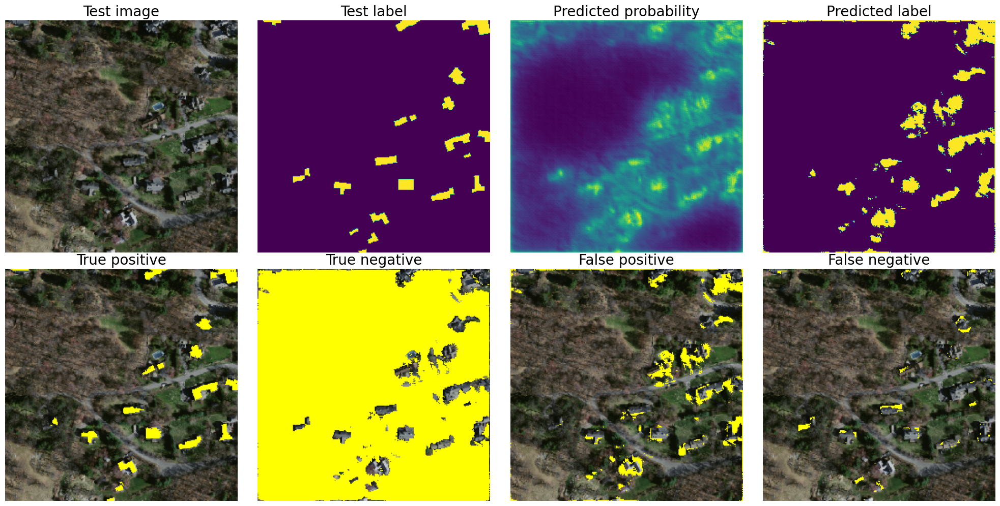

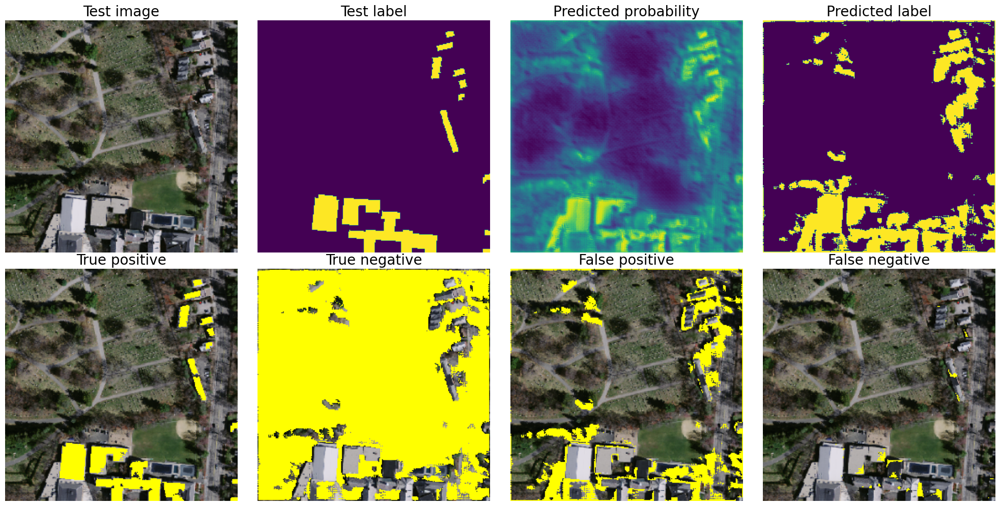

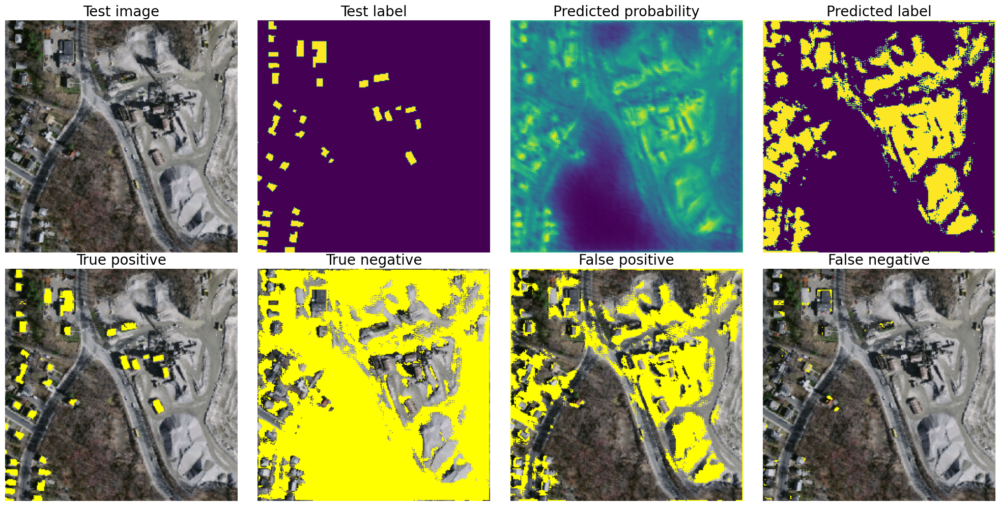

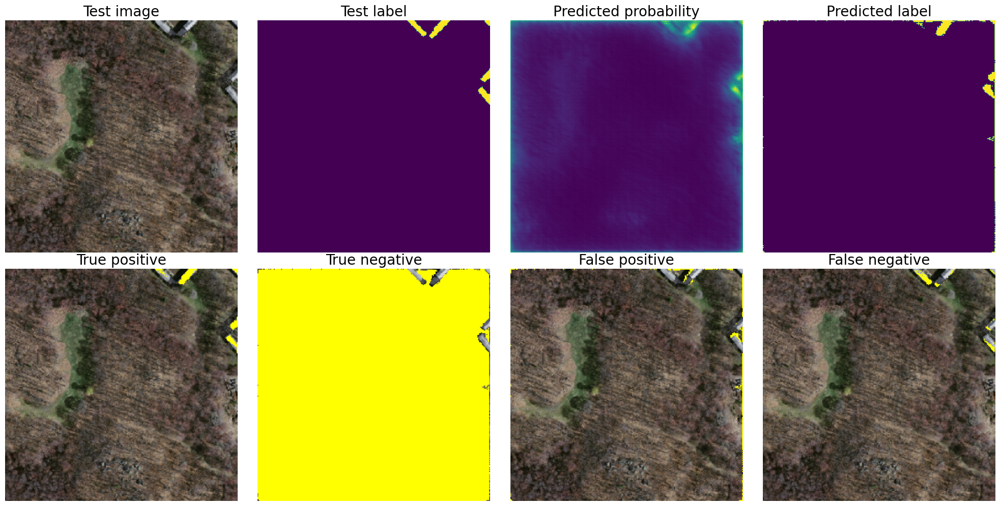

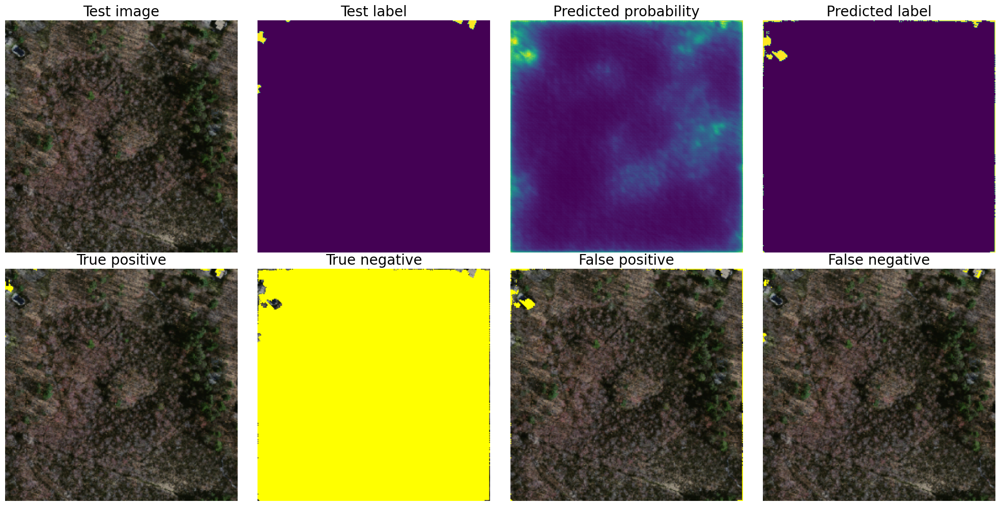

In [65]:
# Display prediction statistics

n_test_images = 5

for i in range(n_test_images):
    display_statistics(images_test_norm[i], labels_test_float[i], predicted_probabilities[i], binary_predictions_roc[i])

The images show that the model with the optimized threshold is assigning the positive class too often, but is capturing better the areas of the buildings compared to the previous threshold. This means that the threshold is slightly too low as the False Positives are shown to be consistently too high. The threshold should be set in between the two cases.

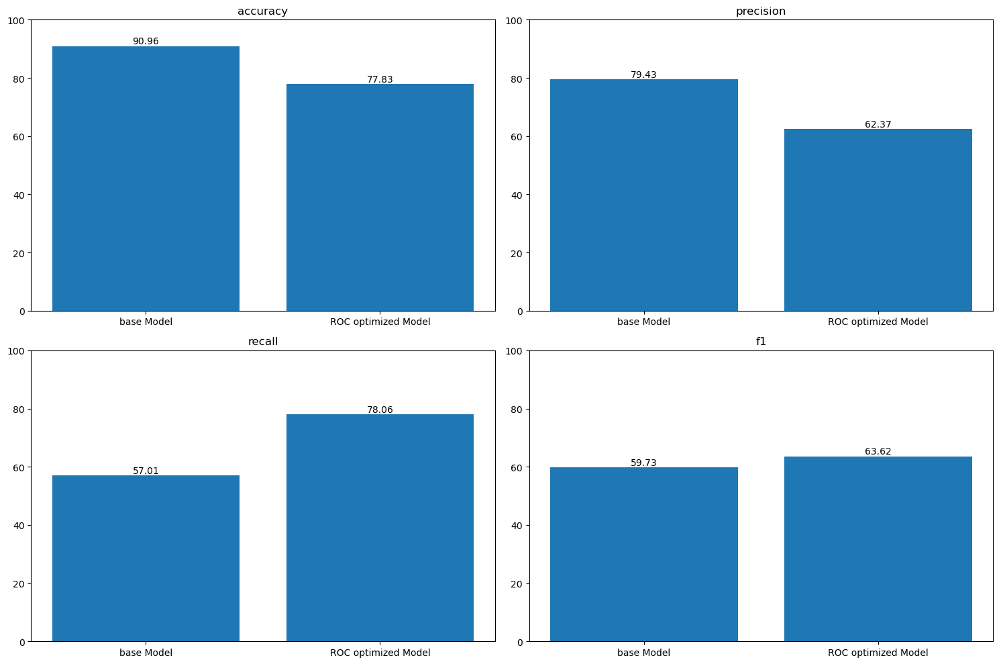

In [271]:
metrics_val.run(labels_test_flat, binary_predictions_roc.reshape(-1), "ROC optimized Model")
metrics_val.plot()

The metrics show that other than the IoU the threshold has improved also the F1 score of the model by sacrificing some precision and accuracy and improving recall.

We will try using the Precision-Recall curve to set the treshold.

In [103]:
# Flatten the test labels
labels_test_flat = labels_test.reshape(-1)

# Compute Precision-Recall curve
precision, recall, thresholds = precision_recall_curve(labels_test_flat, predicted_probabilities.reshape(-1))

# Compute the F1 score for each threshold
f1_scores = 2 *(precision * recall)/(precision + recall)

# Replacing the missing values due to the division by zero with 0
f1_scores[np.where(np.isnan(f1_scores))]=0

# Finding the index of the maximum F1 score
optimal_idx = np.argmax(f1_scores)
optimal_threshold_pr = thresholds[optimal_idx]

# Coordinates of the optimal threshold
optimal_precision = precision[optimal_idx]
optimal_recall = recall[optimal_idx]

print(f'Optimal Threshold from Precision-Recall Curve: {optimal_threshold_pr:.3f}')


Optimal Threshold from Precision-Recall Curve: 0.394


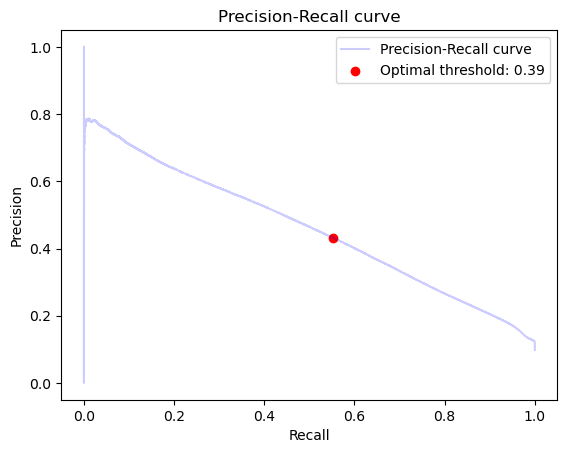

In [106]:
# Optionally, plot the Precision-Recall curve
plt.figure()
plt.plot(recall, precision, color='b', alpha=0.2,
         label='Precision-Recall curve')
plt.scatter(optimal_recall, optimal_precision, color='r', marker='o',
            label=f'Optimal threshold: {optimal_threshold_pr:.2f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc='best')
plt.title('Precision-Recall curve')
plt.show()

The optimal threshold is higher than the one found with the roc curve as it was desired after analyzing the results.

In [109]:
# Check the preformance using Optimal Threshold (PR)
binary_predictions_pr = (predicted_probabilities > optimal_threshold_pr).astype(int)
print(f'Mean IoU (PR): {compute_iou(labels_test_float, binary_predictions_pr):.3f}')

Mean IoU (PR): 0.320


The IoU value is significantly higher showing that this threshold optimizes further the model performance. We will check the results checking the performance of the model on the example images shown before.

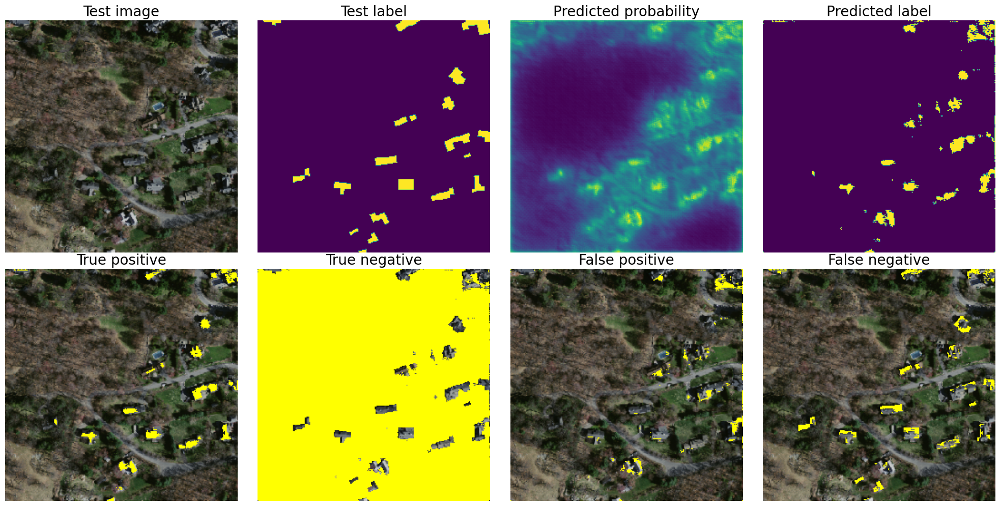

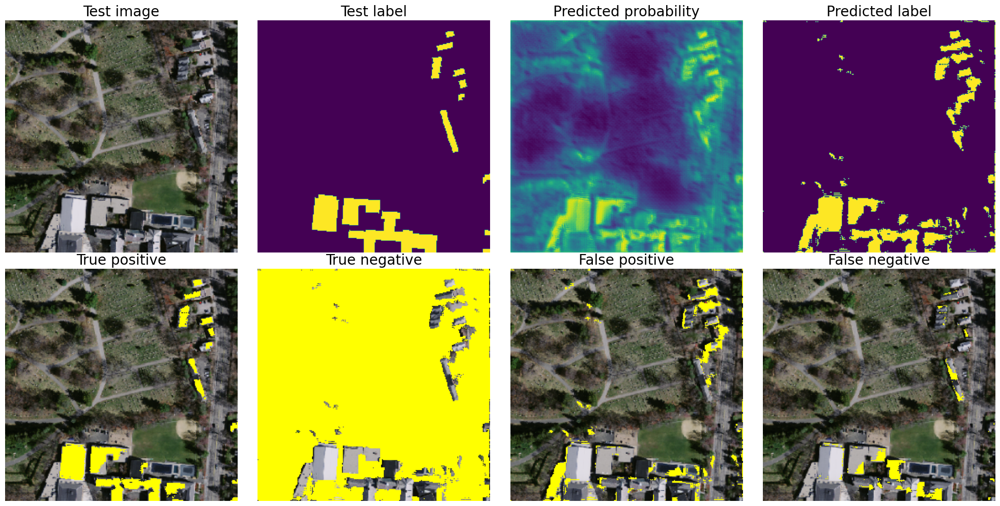

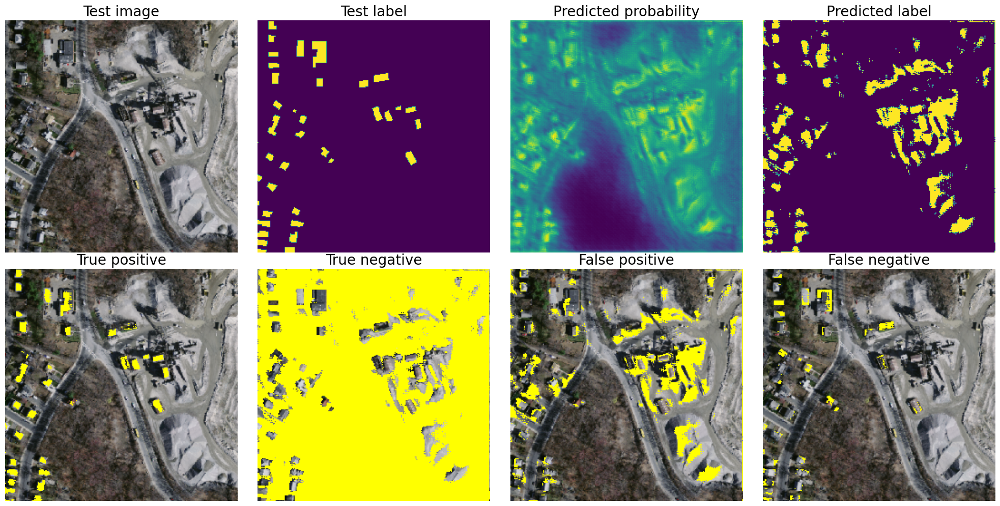

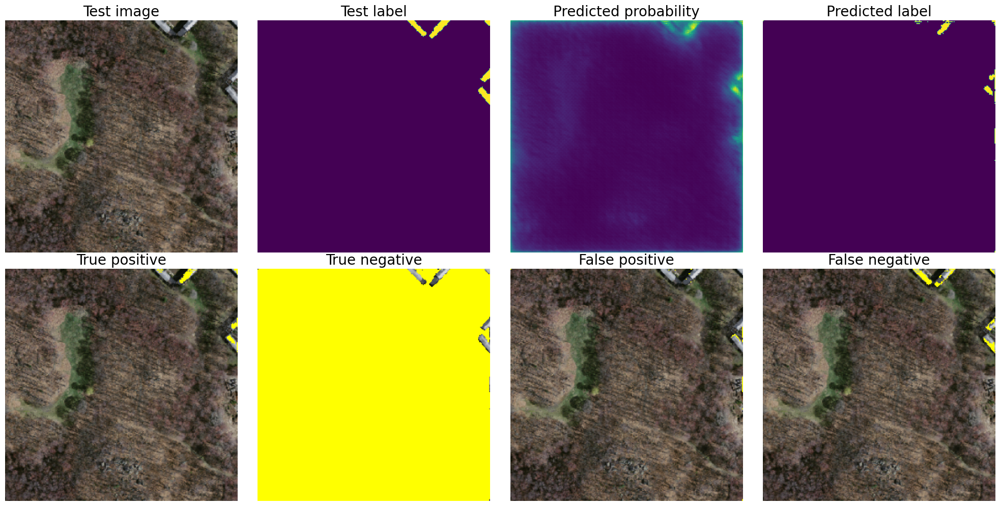

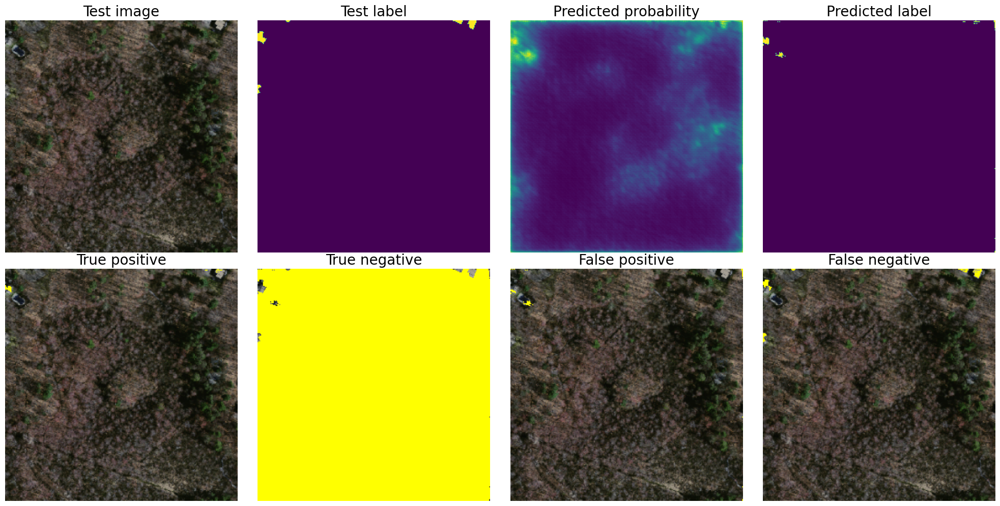

In [108]:
# Display prediction statistics

n_test_images = 5

for i in range(n_test_images):
    display_statistics(images_test_norm[i], labels_test_float[i], predicted_probabilities[i], binary_predictions_pr[i])

The results show that the threshold computed using the Precision-Recall curve makes the model perform much better in its segmentation task and have a good balance between precision and recall. Based on the user needs this threshold can be slightly tweaked to obtain a more optimized model and maximize a personalized model performance. 

However, in general the best way to improve the performance would be to improve the actual model, with different architectures or data processing to obtain higher probabilities in the detection of the segmentation objects in the image. We will do such in the following section.

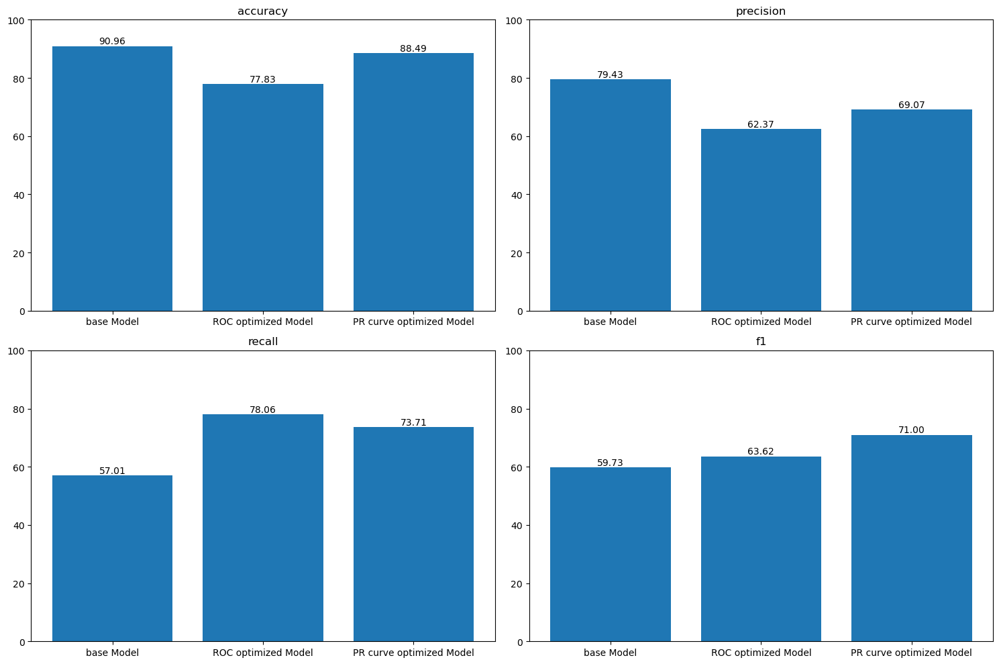

In [272]:
metrics_val.run(labels_test_flat, binary_predictions_pr.reshape(-1), "PR curve optimized Model")
metrics_val.plot()

Metrics again confirm that the improvement in the IoU is followed by an improvement in the F1 score by 8 percentage point compared to the model optimized with the ROC curve. This final model has a very balanced performance in the metrics that create a high F1 score.

9. Modifying the network with image augmentation techniques to increase the robustness of the model.

#### Data Augmentation

In [274]:
image_model_augmented = get_model(img_size)

# Compile the model
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
image_model_augmented.compile(optimizer=optimizer, loss=tf.keras.losses.BinaryFocalCrossentropy(), metrics=['accuracy', 'precision', 'recall'])

# Summary of the model
image_model_augmented.summary()

In [275]:
# Create an ImageDataGenerator for data augmentation
train_datagen = ImageDataGenerator(
  # rotation_range=30,      # Randomly rotate images by up to 30 degrees
# #  width_shift_range=0.2,  # Randomly shift images horizontally by up to 20% of the width
# #  height_shift_range=0.2, # Randomly shift images vertically by up to 20% of the height
# #  shear_range=0.2,        # Shear intensity (shear angle in counter-clockwise direction in radians)
#  # zoom_range=0.2,         # Randomly zoom images by up to 20%
  horizontal_flip=True   # Randomly flip images horizontally
  # vertical_flip=True,    # Randomly flip images vertically
  # brightness_range=[0.8, 1.2], # Randomly adjust brightness
#  fill_mode='nearest'     # Strategy for filling in newly created pixels
)


In [276]:
history = image_model_augmented.fit(
                # Augment the training data
                x = train_datagen.flow(images_train_norm, labels_train_float, batch_size=batch_size, shuffle=True),
                batch_size=batch_size, 
                epochs=30, 
                callbacks=[EarlyStopping(patience=3, monitor='val_loss', restore_best_weights=True)],
                validation_data=[images_valid_norm, labels_valid_float])

Epoch 1/30


/Users/user/miniforge3/envs/tensorflow-metal/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


8/8 ━━━━━━━━━━━━━━━━━━━━ 82s 7s/step - accuracy: 0.6483 - loss: 0.1576 - precision: 0.1078 - recall: 0.3117 - val_accuracy: 0.8637 - val_loss: 0.1362 - val_precision: 0.1264 - val_recall: 0.0085
Epoch 2/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 32s 4s/step - accuracy: 0.8839 - loss: 0.1202 - precision: 0.1153 - recall: 0.0063 - val_accuracy: 0.8675 - val_loss: 0.1332 - val_precision: 0.1311 - val_recall: 0.0036
Epoch 3/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.8811 - loss: 0.1135 - precision: 0.1130 - recall: 0.0034 - val_accuracy: 0.8679 - val_loss: 0.1247 - val_precision: 0.1363 - val_recall: 0.0033
Epoch 4/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.8856 - loss: 0.1082 - precision: 0.1002 - recall: 0.0028 - val_accuracy: 0.8683 - val_loss: 0.1145 - val_precision: 0.1391 - val_recall: 0.0028
Epoch 5/30
8/8 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.8827 - loss: 0.1027 - precision: 0.1146 - recall: 0.0024 - val_accuracy: 0.8689 - val_loss: 0.1038 - val_precision: 0.1106 - 

[0.12981410324573517, 0.12321583926677704, 0.11147277802228928, 0.10218845307826996, 0.1026657298207283, 0.09656701982021332, 0.09276770800352097, 0.09166751801967621, 0.09509008377790451, 0.09064865857362747, 0.08933442831039429, 0.09161598235368729, 0.08836177736520767, 0.08705653250217438, 0.0838732048869133, 0.08862076699733734, 0.08424993604421616, 0.08292651176452637, 0.08404084295034409, 0.08253686875104904, 0.08352258801460266, 0.08559639006853104, 0.08132892847061157, 0.08260820060968399, 0.08178968727588654, 0.08070399612188339, 0.08074117451906204, 0.08002543449401855, 0.08068422228097916, 0.07921352982521057]


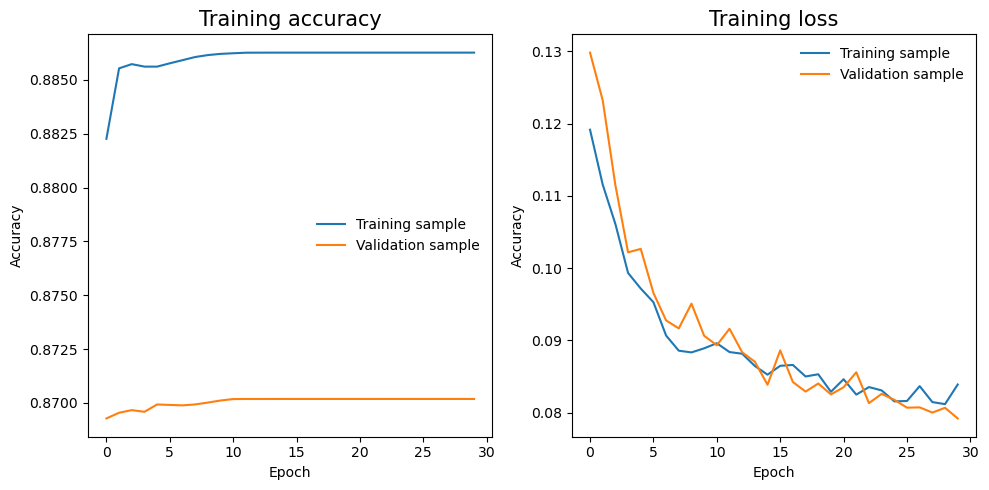

In [277]:
print(history_augmented.history['val_loss'])
display_history(history_augmented.history)

The model is again converging and the validation loss is decreasing at a similar rate to the training loss. The model was experiencing vanishing gradients with a low learning rate and was not really able to uncover the underlying patterns in the images. Increasing the learning rate has improved its performance and led to convergence.

In [278]:
# Predict probabilities for the test set
predicted_probabilities_augmented = image_model_augmented.predict(images_test_norm)

2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step


In [279]:
# Compute Precision-Recall curve
precision, recall, thresholds_augmented = precision_recall_curve(labels_test_flat, predicted_probabilities_augmented.reshape(-1))

# Calculate F1 scores while handling potential division by zero
f1_scores_augmented = np.zeros_like(precision)
for i, (p, r) in enumerate(zip(precision, recall)):
    if p + r == 0:
        f1_scores_augmented[i] = 0
    else:
        f1_scores_augmented[i] = 2 * (p * r) / (p + r)

# Find the optimal threshold based on F1 score
optimal_threshold_augmented = thresholds_augmented[np.argmax(f1_scores_augmented)]

# Convert probabilities to binary predictions using the optimal threshold
binary_predictions_augmented = (predicted_probabilities_augmented > optimal_threshold_augmented).astype(int)
print(f'Mean IoU (Augmented): {compute_iou(labels_test_float, binary_predictions_augmented):.2f}')

Mean IoU (Augmented): 0.3267849035391789


In [280]:
binary_predictions_augmented=(predicted_probabilities > optimal_threshold_augmented).astype(int)

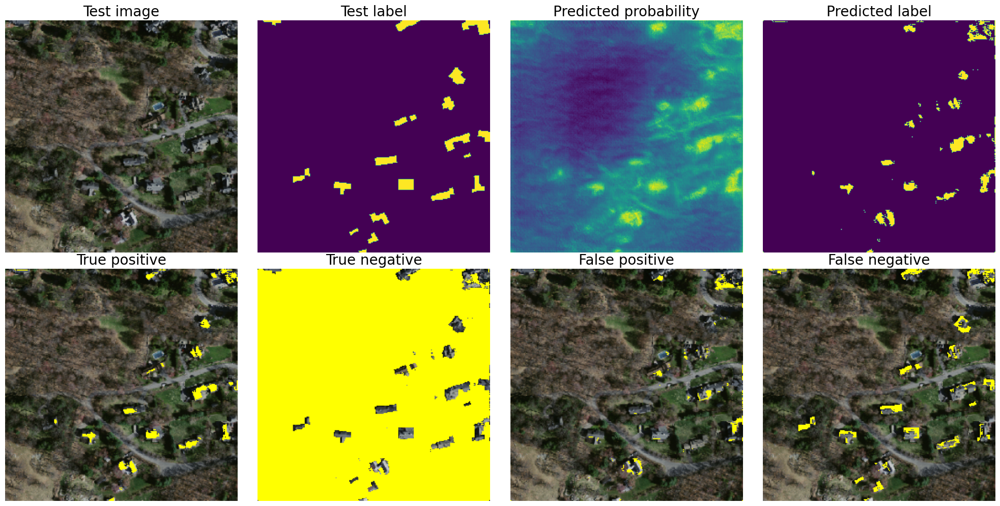

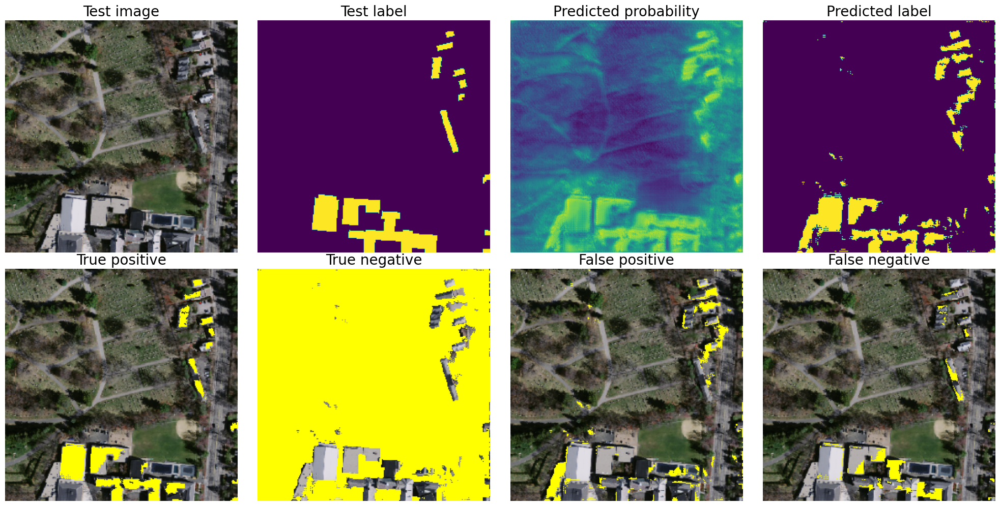

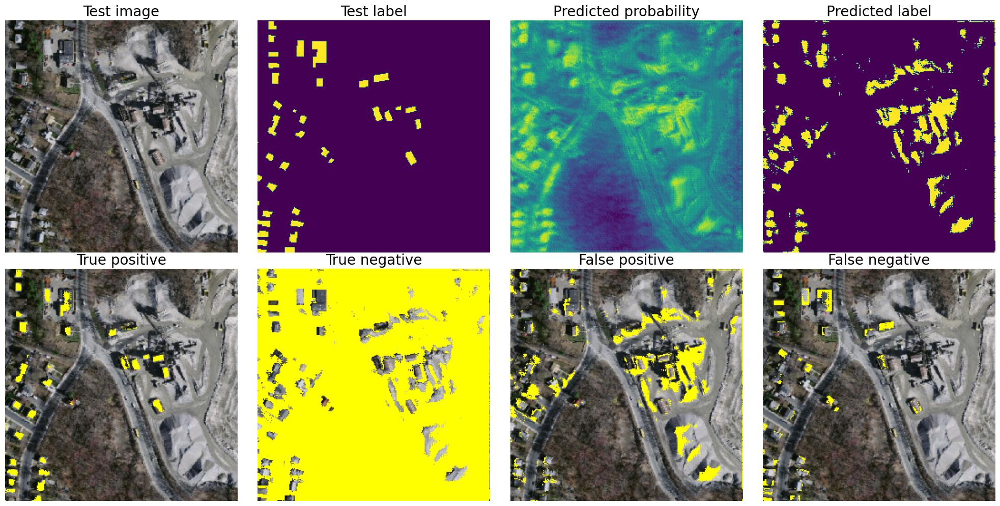

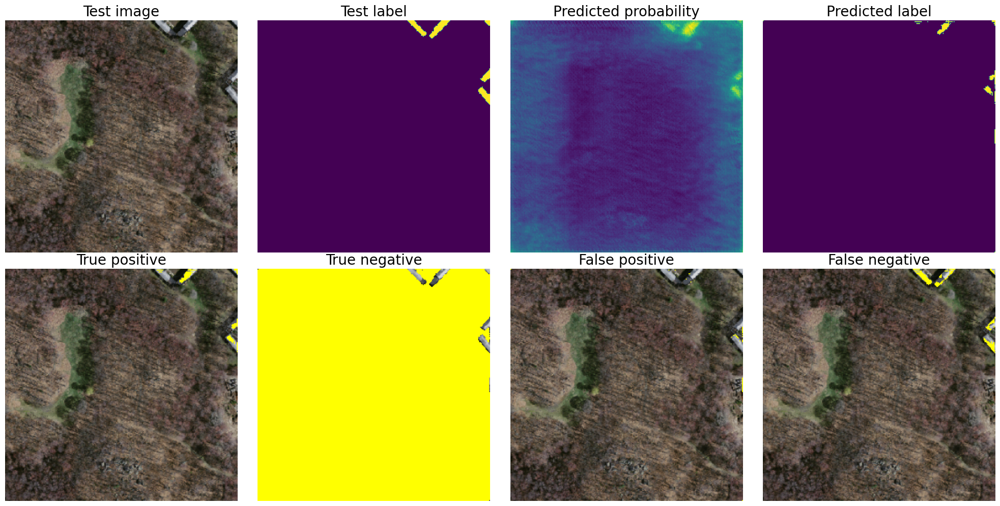

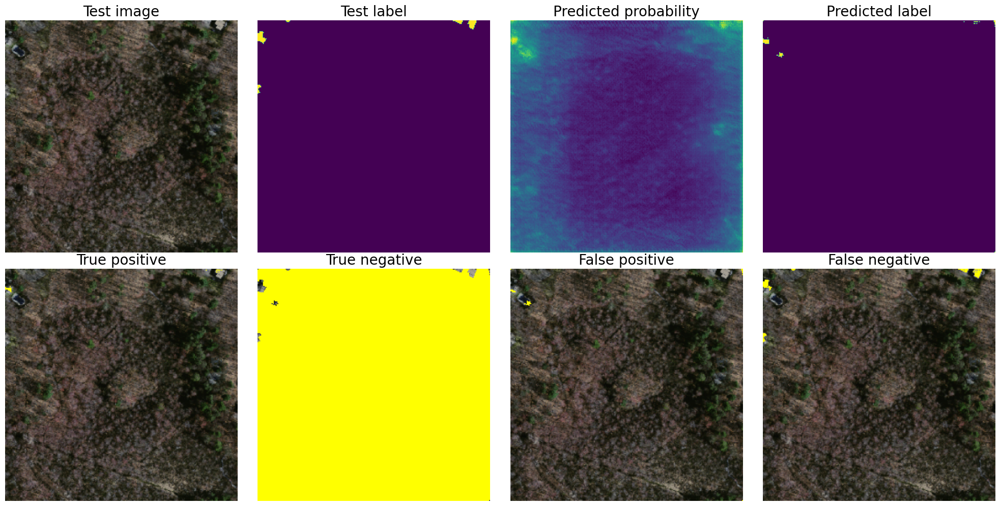

In [281]:
# Display prediction statistics

n_test_images = 5

for i in range(n_test_images):
    display_statistics(images_test_norm[i], labels_test_float[i], predicted_probabilities_augmented[i], binary_predictions_augmented[i])

We can see that the model is working better adding horizontal flips to the training phase. The IoU is slightly higher meaning that the model is capturing the buildings in the images in a more consistent way. Other types of augmentation were proving to decrease the model performance so have been excluded from the image generator class arguments.

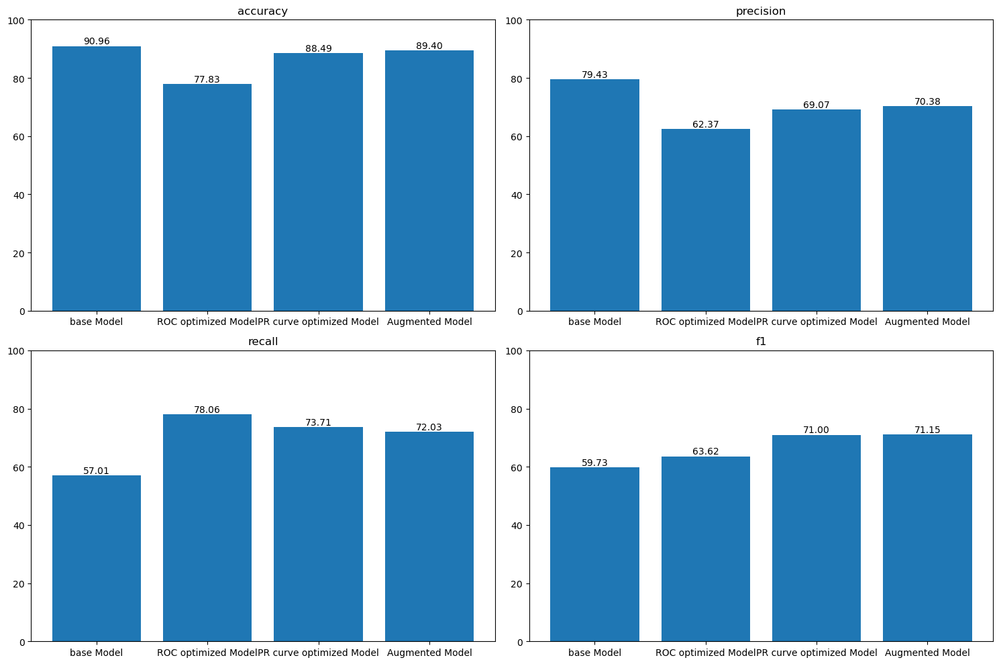

In [283]:
metrics_val.run(labels_test_flat, binary_predictions_augmented.reshape(-1), "Augmented Model")
metrics_val.plot()

The metrics show just a slight increase in the performance of the model also due to the fact that the augmentation was just consisting in horizontal flips. Yet this might give some additional robustness to the model. 